In [4]:
import pandas as pd 
import datetime
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import numpy as np
import plotly.express as px
plt.style.use('ggplot')

In [5]:
df = pd.read_csv(
    'ChargePoint Data CY20Q4.csv', dtype={'Station Name': str}, 
    parse_dates=['Start Date'], infer_datetime_format=True, low_memory=False)

# Make a unique id for each row
df['Id'] = df.index
# Drop columns that are not needed
df.drop(
    ['User ID', 'County', 'City', 'Postal Code', 'Driver Postal Code',
    'State/Province', 'Fee', 'Currency', 'EVSE ID', 'Transaction Date (Pacific Time)',
    'GHG Savings (kg)', 'Gasoline Savings (gallons)', 'Org Name',
    'Address 1', 'System S/N', 'Plug In Event Id', 'Ended By',
    'End Time Zone', 'Start Time Zone', 'Country', 'Model Number'
    ], axis=1, inplace=True)

df.isna().sum()

Station Name                 0
MAC Address                  0
Start Date                   0
End Date                     0
Total Duration (hh:mm:ss)    0
Charging Time (hh:mm:ss)     0
Energy (kWh)                 0
Port Type                    9
Port Number                  0
Plug Type                    0
Latitude                     0
Longitude                    0
Id                           0
dtype: int64

In [6]:
# There's Excel formatting in the End Data column, so we need to convert from Excel serial to datetime
# https://stackoverflow.com/questions/6706231/fetching-datetime-from-float-in-python
def convert_to_datetime(serial):
    try:
        return pd.to_datetime(serial)
    except:
        seconds = (float(serial) - 25569) * 86400.0
        return datetime.datetime.utcfromtimestamp(seconds)

df['End Date'] = df['End Date'].apply(convert_to_datetime)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259415 entries, 0 to 259414
Data columns (total 13 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Station Name               259415 non-null  object        
 1   MAC Address                259415 non-null  object        
 2   Start Date                 259415 non-null  datetime64[ns]
 3   End Date                   259415 non-null  datetime64[ns]
 4   Total Duration (hh:mm:ss)  259415 non-null  object        
 5   Charging Time (hh:mm:ss)   259415 non-null  object        
 6   Energy (kWh)               259415 non-null  float64       
 7   Port Type                  259406 non-null  object        
 8   Port Number                259415 non-null  int64         
 9   Plug Type                  259415 non-null  object        
 10  Latitude                   259415 non-null  float64       
 11  Longitude                  259415 non-null  float64 

## Create clusters based on Station Names

In [7]:
print("Number of unique stations:", df['Station Name'].nunique())
df['Cluster'] = df['Station Name'].str.split(' ').str[4]
print(df['Cluster'].value_counts())

Number of unique stations: 47
BRYANT       47100
HIGH         39901
HAMILTON     38609
WEBSTER      37585
CAMBRIDGE    32879
MPL          28326
RINCONADA    18264
TED          16712
SHERMAN         39
Name: Cluster, dtype: int64


## Plot the stations on a map

In [8]:
# plot the geographical distribution of the charging stations
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Station Name")
fig.update_layout(
    height=600, 
    mapbox_style="open-street-map", 
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox_zoom=10, # zoom into the map
    mapbox_center_lat=df['Latitude'].mean(), mapbox_center_lon=df['Longitude'].mean() # center the map
    )
fig.show()

[]

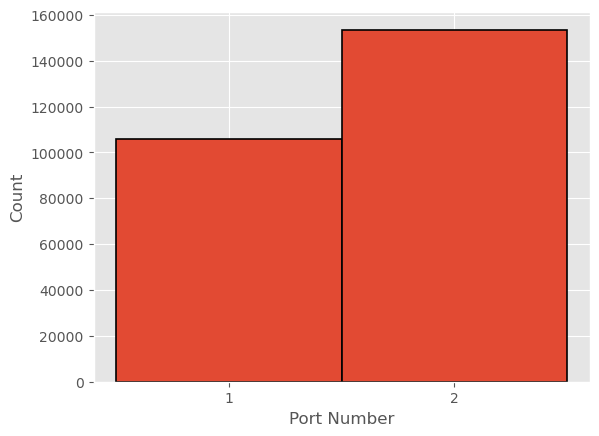

In [9]:
bins = np.arange(1, df['Port Number'].max() + 1.5) - 0.5
# then you plot away
fig, ax = plt.subplots()
_ = ax.hist(df['Port Number'], bins, edgecolor='k', linewidth=1.2)
ax.set_xticks(bins + 0.5)
ax.set_xlabel('Port Number')
ax.set_ylabel('Count')
plt.plot()

In [15]:
df_combined = pd.DataFrame()
for cluster in df['Cluster'].unique():
    test_df = df[df['Cluster'] == cluster]
    test_df.loc[:,'Period'] = [pd.date_range(s, e, freq='T') for s, e in zip(test_df['Start Date'], test_df['End Date'])]
    res = test_df.explode('Period').groupby(pd.Grouper(key='Period', freq='60T'))['Energy (kWh)'].nunique()
    # rename energy to sessions
    res.rename('Sessions', inplace=True)
    data = res.to_frame()
    data = data.reset_index()
    data.Period = pd.to_datetime(data.Period)
    data["Cluster"] = cluster
    df_combined = pd.concat([df_combined, data])

/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81632 entries, 0 to 81631
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    81632 non-null  datetime64[ns]
 1   Sessions  81632 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 1.2 MB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81787 entries, 0 to 81786
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    81787 non-null  datetime64[ns]
 1   Sessions  81787 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 1.2 MB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80983 entries, 0 to 80982
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    80983 non-null  datetime64[ns]
 1   Sessions  80983 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 1.2 MB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54987 entries, 0 to 54986
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    54987 non-null  datetime64[ns]
 1   Sessions  54987 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 859.3 KB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48271 entries, 0 to 48270
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    48271 non-null  datetime64[ns]
 1   Sessions  48271 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 754.4 KB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47577 entries, 0 to 47576
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    47577 non-null  datetime64[ns]
 1   Sessions  47577 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 743.5 KB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43520 entries, 0 to 43519
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    43520 non-null  datetime64[ns]
 1   Sessions  43520 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 680.1 KB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43521 entries, 0 to 43520
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    43521 non-null  datetime64[ns]
 1   Sessions  43521 non-null  int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 680.1 KB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 534 entries, 0 to 533
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Period    534 non-null    datetime64[ns]
 1   Sessions  534 non-null    int64         
dtypes: datetime64[ns](1), int64(1)
memory usage: 8.5 KB
None


/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_3660/2588203613.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [21]:
df_combined.head()

,Period,Sessions,Cluster
0,2011-07-29 20:00:00,1,HAMILTON
1,2011-07-29 21:00:00,1,HAMILTON
2,2011-07-29 22:00:00,1,HAMILTON
3,2011-07-29 23:00:00,1,HAMILTON
4,2011-07-30 00:00:00,1,HAMILTON


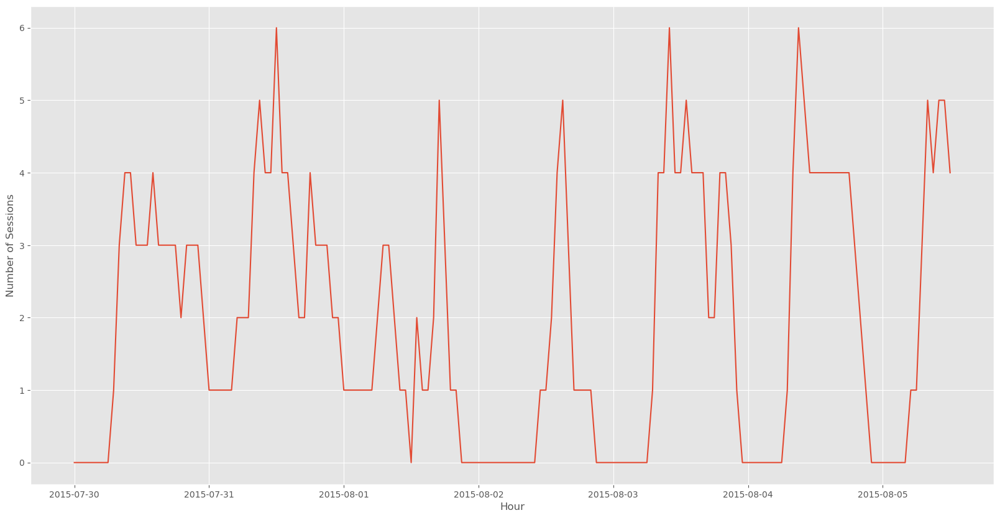

In [13]:
fig, ax = plt.subplots(figsize=(20, 10))
ax.plot(res.iloc[11:24*7])
# Make y-axis integral
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
ax.set_xlabel('Hour')
ax.set_ylabel('Number of Sessions')
plt.show()